## This notebooks makes animations of the Gale Shapley algorithm

In [9]:
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import os
import random
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from matplotlib.lines import Line2D
from itertools import product
from tools import gale_shapley,reverse,make_preferences
import io
import matplotlib.animation as animation

In [4]:
import matplotlib as mpl

# Set the embed limit to, for example, 50 MB
mpl.rcParams['animation.embed_limit'] = 50.0

# Now, proceed with creating and displaying your animation


## Here we get the images of the characters

In [5]:
dir_path="/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley"
dir_path_women=dir_path+"/Women"
dir_path_men=dir_path+"/Men"
women_image_paths = os.listdir(dir_path_women)
women_image_paths=[dir_path_women+"/"+item for item in women_image_paths if item[-1]=="g"]
women_image_paths.sort()
men_image_paths=os.listdir(dir_path_men)
men_image_paths=[dir_path_men+"/"+item for item in men_image_paths if item[-1]=="g"]
men_image_paths.sort()
image_paths=women_image_paths+men_image_paths
men_names=[item.split('/')[-1] for item in men_image_paths]
men_names=[name.split('.')[0] for name in men_names]
women_names=[item.split('/')[-1] for item in women_image_paths]
women_names=[name.split('.')[0] for name in women_names]


In [11]:
dir_path="/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley"
dir_path_hosp=dir_path+"/Hospitals"
hosp_image_paths = os.listdir(dir_path_hosp)
hosp_image_paths=[dir_path_hosp+"/"+item for item in hosp_image_paths if item[-1]=="g"]



In [12]:
hospitals=[Image.open(item) for item in hosp_image_paths]

In [13]:
def textsize(text, font):
    im = Image.new(mode="P", size=(0, 0))
    draw = ImageDraw.Draw(im)
    _, _, width, height = draw.textbbox((0, 0), text=text, font=font)
    return width, height

In [17]:
def write_name(image_path):
    with Image.open(image_path) as img:
        draw = ImageDraw.Draw(img)
        # Split the path by the forward slash
        parts = image_path.split('/')

        # The last part is the file name and remove extention
        text = parts[-1].split(".")[0]
    
        # Access the built-in "DejaVuSans" font
        #Use the default font
        font_size=250
        font = ImageFont.truetype("/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/DejaVuSans.ttf", font_size)
        
        # Position and color
        text_width, text_height =textsize(text, font=font)
        # Calculate the x-coordinate for the text to be centered
        x = (img.width - text_width) / 2
        # Set the y-coordinate for the vertical position
        y = 0.7*(img.height)  # For example, 10 pixels from the top

        text_position = (x, y)
        text_color = "#FFBB00"
        
        # Draw the text
        draw.text(text_position, text, fill=text_color, font=font)
        
        # Save or display the image
        # output_path = 'path_to_your_output_image.jpg'
        # img.save(output_path)
        return img

In [ ]:
women_image_paths

In [19]:
Women=[write_name(path) for path in women_image_paths ]
Men=[write_name(path) for path in men_image_paths ]
People=Women+Men

In [20]:
image_dict=dict()
for i,name in enumerate(women_names):
    image_dict[name]=Women[i]
for i,name in enumerate(men_names):
    image_dict[name]=Men[i]
for i in range(4):
    image_dict["Hospital_"+str(i)]=hospitals[i]

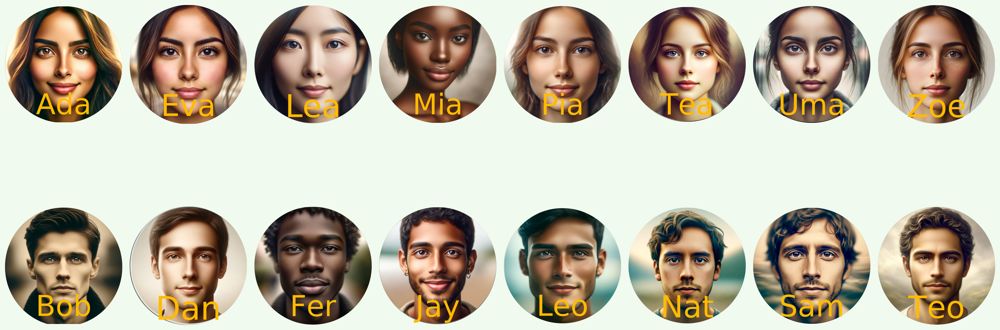

In [12]:




# Set up the figure and axes for a 2x4 grid
fig, axs = plt.subplots(2, 8, figsize=(20, 10),dpi=300)
fig.patch.set_facecolor('#F1FAEE')

# Flatten the array of axes to make iterating easier
axs = axs.ravel()

for i, img in enumerate(People):
    axs[i].imshow(img)  # Display each image
    axs[i].axis('off')  # Turn off axis

plt.tight_layout()  # Adjust subplots to fit into the figure area.
plt.show()


In [13]:
fig.savefig("cast.png")

In [ ]:


# # Number of images
# n_images = len(image_paths)

# # Grid size
# cols = 8  # Set the number of columns you want in your grid
# rows = n_images // cols + (n_images % cols > 0)  # Calculate the number of rows needed

# # Create a figure to hold the grid
# fig, axs = plt.subplots(rows, cols, figsize=(13, 13))
# fig.tight_layout(pad=0)
# ## Adjust vertical space
# fig.subplots_adjust(hspace=-0.5)
# fig.patch.set_facecolor('lightyellow')
# # Hide unused subplots if the number of images is not a perfect fit for the grid
# if n_images % cols > 0:
#     for idx in range(n_images, rows * cols):
#         axs.flat[idx].axis('off')

# # # Loop through the images and add them to the grid
# # for i, img_papth in enumerate(image_paths):
# #     img = Image.open(img_path)
# #     ax = axs.flat[i]
# #     ax.imshow(img)
# #     ax.axis('off')  # Hide the axis
        

# # Loop through the images and add them to the grid
# for i, img in enumerate(People):
#     ax = axs.flat[i]
#     ax.imshow(img)
#     ax.axis('off')  # Hide the axis        
# coordinates=[]
# for i, ax in enumerate(axs.flat):
#     position = ax.get_position()
#     DX=position.width/2
#     DY=position.height
#     if i<8:
#         DY=0
#     coordinates.append((position.x0+DX,position.y0+DY))
# for i in range(5):
#     a=np.random.choice(range(8))
#     b=np.random.choice(range(8))+8
#     plt.plot([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], color="Teal",transform=fig.transFigure, clip_on=False,lw=4)

# plt.show()

In [22]:

def draw_com(people:list,proposals:list,relationships:list,p_matrix,d_matrix,title,alphabetical=True,men_propose=True):
    cols=len(d_matrix)
    ##
    proponents=people[:cols]
    disponents=people[cols:]
    if not alphabetical:
        proponents=proponents[::-1]
        disponents=disponents[::-1]
    if not men_propose:
        disponents=people[:cols]
        proponents=people[cols:]
        if not alphabetical:
            proponents=proponents[::-1]
            disponents=disponents[::-1]
    

    
    # Create figure
    fig = plt.figure(figsize=(8, 5),dpi=300)
    fig.tight_layout(pad=-4)
    fig.subplots_adjust(hspace=-0.2)  # Adjust vertical space
    fig.patch.set_facecolor('#F1FAEE')
    gridsize=(5,8)

    # Add a title to the figure
    fig.suptitle(title, fontsize=15,color="#1D3557",y=0.9)  # You can adjust the fontsize as needed

    ## Make a dictinary with the places in the grid
    spots=dict()
    ## Shift people
    shift=(8-cols)//2
    for i in range(cols): 
        spots["proponent_"+str(i)]=plt.subplot2grid(gridsize, (2, i+shift), colspan=1, rowspan=1)
        spots["proponent_"+str(i)].axis('off')
        spots["proponent_"+str(i)].imshow(image_dict[proponents[i]])

        spots["disponent_"+str(i)]=plt.subplot2grid(gridsize, (4, i+shift), colspan=1, rowspan=1)
        spots["disponent_"+str(i)].axis('off')
        spots["disponent_"+str(i)].imshow(image_dict[disponents[i]])
        

       
    spots["proponents_table"]=plt.subplot2grid(gridsize, (0, 0), colspan=3, rowspan=2)
    spots["proponents_table"].axis('off')
    spots["disponents_table"]=plt.subplot2grid(gridsize, (0, 5), colspan=3, rowspan=2)
    spots["disponents_table"].axis('off')
   
    p_preferences=[[disponents[p_matrix[i][j]]for j in range(cols)]for i in range(cols)]
    d_preferences=[[proponents[d_matrix[i][j]]for j in range(cols)]for i in range(cols)]
    for i in range(cols):
        d_table = spots["disponents_table"].table(cellText=d_preferences, rowLabels=disponents, loc='center', cellLoc='center')
        d_table.auto_set_font_size(False)  # Disable automatic font size adjustment
        d_table.set_fontsize(8)

        p_table = spots["proponents_table"].table(cellText=p_preferences, rowLabels=proponents, loc='center', cellLoc='center')
        p_table.auto_set_font_size(False)  # Disable automatic font size adjustment
        p_table.set_fontsize(8)
    # Create the table
    # Creating the table at the bottom of the plot
    # Set the background color for all cells, including header cells
    table_cells = d_table.properties()["celld"]
    background_color1 = "#457B9D"  # Light red, for example
    background_color2 = "#A8DADC"  # Light red, for example
    # Define colors
    label_background_color = '#FFD700'  # Gold for labels
    data_background_color = '#F1FAEE'  # Light blue for data cells
    border_color = '#000000'  # Black border for all cells

    # Apply colors
    for (i, j), cell in d_table.get_celld().items():
        if j == -1:  # row labels are a different color
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
    # Apply colors
    for (i, j), cell in p_table.get_celld().items():
        if j == -1: ## row labels are of different color
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
    
    # Example for drawing lines
    prop_coord = []
    disp_coord = []
    for i in range(cols):
        prop_position = spots["proponent_"+str(i)].get_position()
        disp_position = spots["disponent_"+str(i)].get_position()
        dx = prop_position.width / 2
        dy = prop_position.height 

        disp_position = spots["disponent_"+str(i)].get_position()
        

        prop_coord.append((prop_position.x0 + dx, prop_position.y0 ))
        disp_coord.append((disp_position.x0 + dx, disp_position.y0 + dy))

    # Draw random lines for demonstration
    for (a,b) in proposals:
        plt.plot([prop_coord[a][0], disp_coord[b][0]], [prop_coord[a][1], disp_coord[b][1]], color="#1D3557", transform=fig.transFigure, clip_on=False, lw=2)
    for (a,b) in relationships:
        plt.plot([prop_coord[a][0], disp_coord[b][0]], [prop_coord[a][1], disp_coord[b][1]], color="#E63946", transform=fig.transFigure, clip_on=False, lw=2)

    return fig

## Make Unstable marriage image

In [27]:
k=8
d_matrix=make_preferences(k)
p_matrix=make_preferences(k)

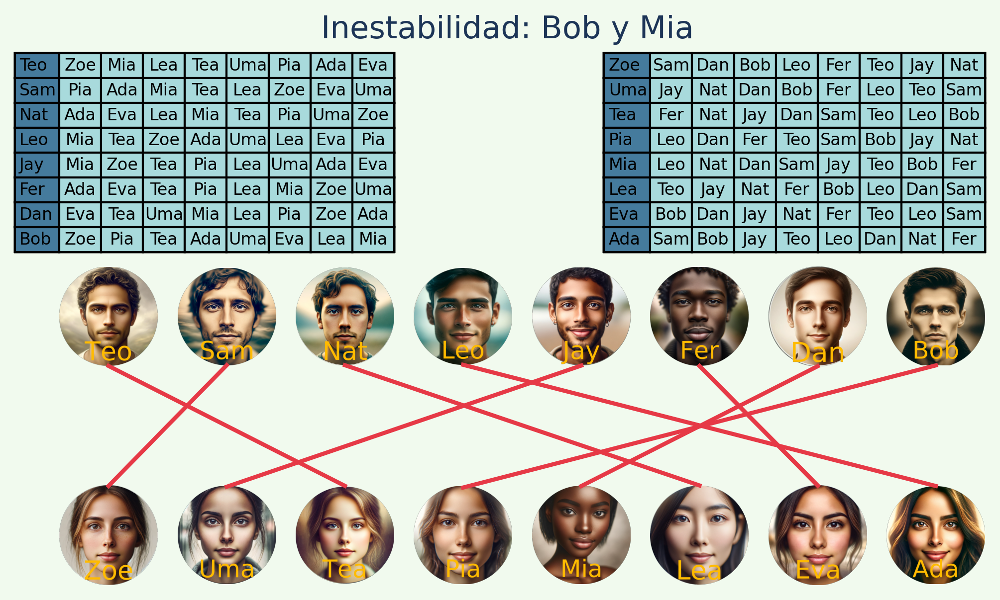

In [32]:

gente=men_names[:k]+women_names[:k]
proposals=[]#[(random.choice(range(k)),random.choice(range(k))) for item in range(3)]
relationships=[(0,2),(2,5),(1,0),(3,7),(4,1),(5,6),(6,4),(5,6),(7,3)]#[(random.choice(range(k)),random.choice(range(k))) for item in range(3)]
img=draw_com(gente,proposals,relationships,p_matrix,d_matrix,"Inestabilidad: Bob y Mia",alphabetical=False,men_propose=True)

### Make plot of the homosexual case


In [20]:
img.savefig("marriage example.png")

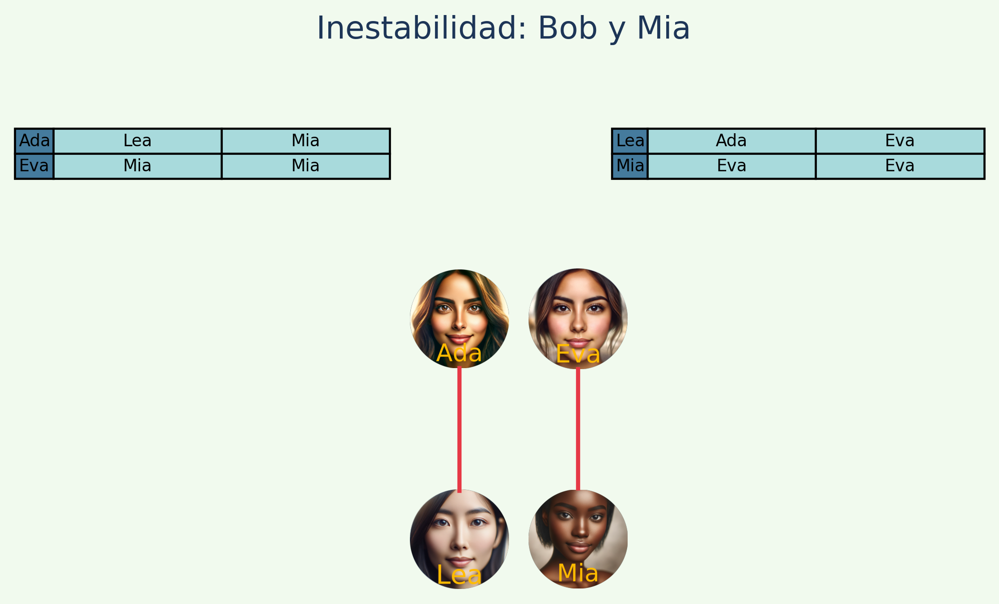

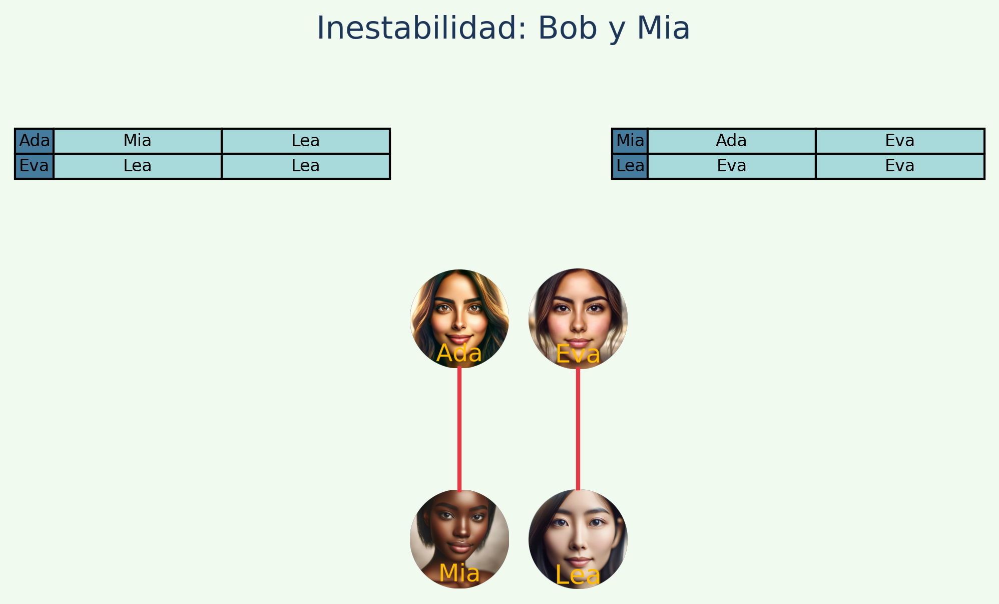

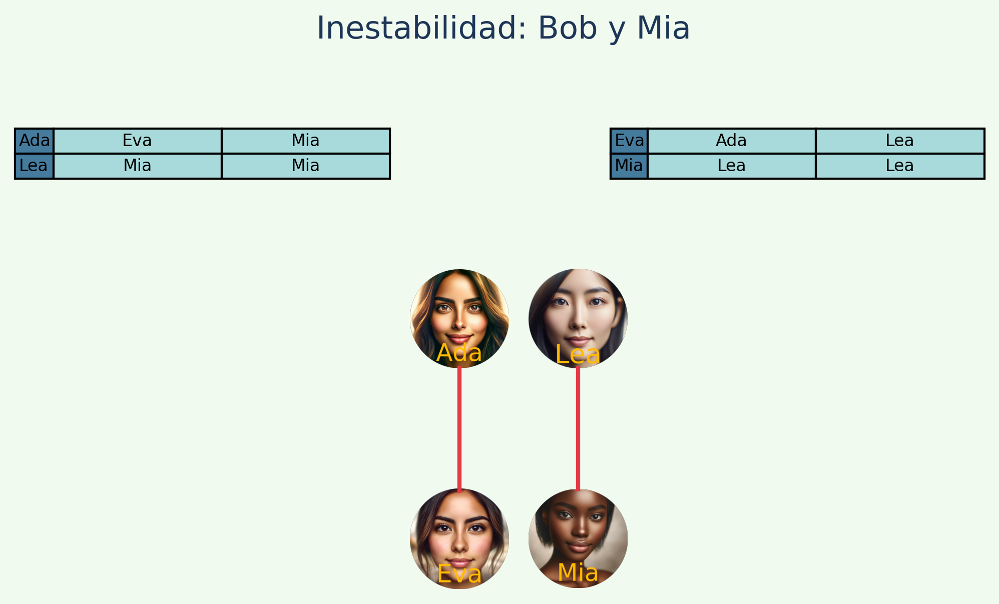

In [204]:
imgs=[]
for possibility in [["Ada","Eva","Lea","Mia"],["Ada","Eva","Mia","Lea"],["Ada","Lea","Eva","Mia"]]:
    d_matrix=[[0,1],[1,1]]
    k=2
    gente=possibility
    proposals=[]#[(random.choice(range(k)),random.choice(range(k))) for item in range(3)]
    relationships=[(0,0),(1,1)]#[(random.choice(range(k)),random.choice(range(k))) for item in range(3)]
    imgs.append(draw_com(gente,proposals,relationships,d_matrix,d_matrix,"Inestabilidad: Bob y Mia",alphabetical=True))

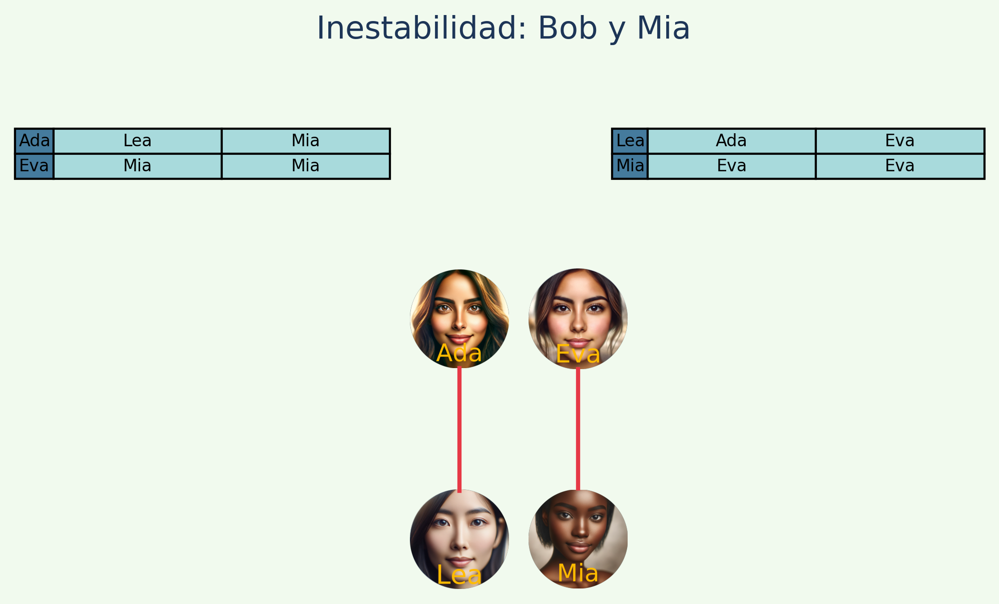

In [134]:
imgs[0]

In [205]:
for i in range(3):    
    images_path="Images_Gale_Shapley/images_for_talk/"
    name="gay_"+str(i)+".png"
    out_path=images_path+name
    imgs[i].savefig(out_path)

In [206]:
cropped=[]
for i in range(3):
    images_path="Images_Gale_Shapley/images_for_talk/"
    name="gay_"+str(i)+".png"
    path=images_path+name
    cropped.append(Image.open(path).crop((900, 600, 1600, 1400)))
    

###

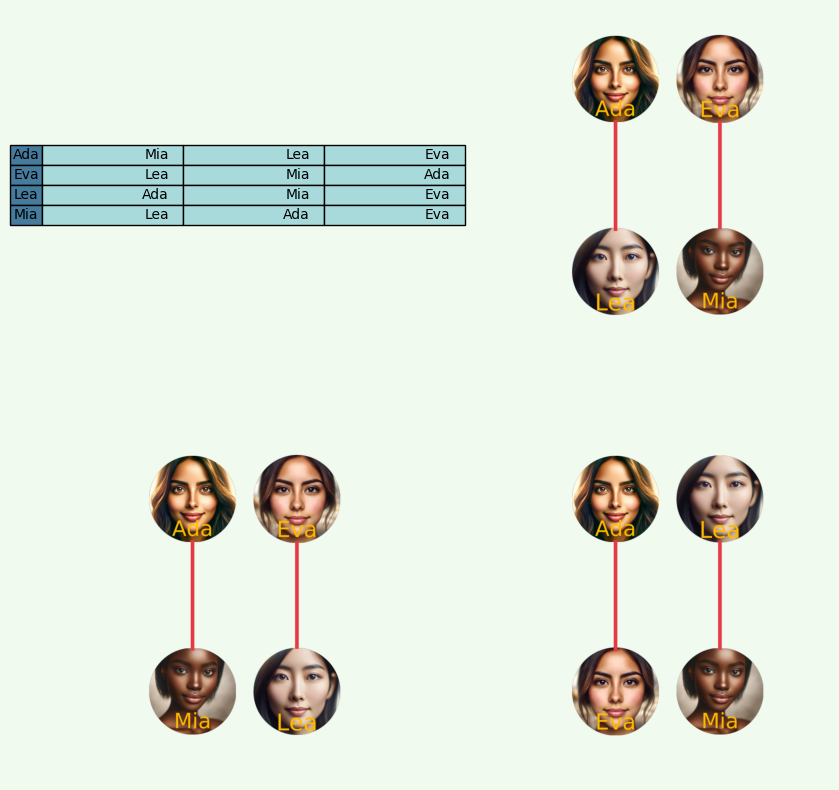

In [217]:
# Create sample data for the table
cell_text = [
    ['Mia', 'Lea', 'Eva'],
    ['Lea', 'Mia', 'Ada'],
    ['Ada', 'Mia', 'Eva'],
    ['Lea','Ada','Eva']

]
rows = ['Ada', 'Eva', 'Lea','Mia']

# Create sample "images" (replace these with actual image data)
image1 = np.random.rand(10, 10)
image2 = np.random.rand(10, 10)
image3 = np.random.rand(10, 10)

# Create a 2x2 grid for the plots
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
fig.patch.set_facecolor('#F1FAEE')

# Remove ticks and labels for all plots
for ax in axs.flat:
    ax.set_xticks([])
    ax.set_yticks([])

# Add a table at the first subplot
axs[0, 0].axis('tight')
axs[0, 0].axis('off')
table = axs[0, 0].table(cellText=cell_text, rowLabels=rows,loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1.2, 1.2)

# Display images in the remaining subplots
axs[0, 1].imshow(cropped[0])
axs[0,1].axis("off")
axs[1, 0].imshow(cropped[1])
axs[1,0].axis("off")
axs[1, 1].imshow(cropped[2])
axs[1,1].axis("off")
background_color1 = "#457B9D"  # Light red, for example
background_color2 = "#A8DADC"  # Light red, for example
for (i, j), cell in table.get_celld().items():
        if j == -1: ## row labels are of different color
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor("black")

plt.show()

In [218]:
images_path="Images_Gale_Shapley/images_for_talk/"
name="gay.png"
out_path=images_path+name
fig.savefig(out_path)

## This function draws a comitment tree

In [ ]:
def new_draw_commitments(people:list, proposals:list, relationships:list,title:str,p_matrix,d_matrix):
    # Assuming 'people' contains paths to image files or PIL images
    n_images = len(people)

    # Calculate grid size
    cols = max(1, n_images // 2)  # Ensure there's at least one column
    rows = n_images // cols + (n_images % cols > 0)+1
    # circle_size=50/cols

    # Create figure and axes for the grid
    #fig, axs = plt.subplots(rows, cols, figsize=(1.3*circle_size,circle_size))
    #add title
    fig = plt.figure(figsize=(10, 6))
   # Define grid size (rows, cols)
    gridsize = (rows, cols)

    ##
    # Place subplots
    ax1 = plt.subplot2grid(gridsize, (0, 0), colspan=cols, rowspan=1)
    ax2 = plt.subplot2grid(gridsize, (1, 0),colspan=cols, rowspan=1)
   
    # Add a title to the figure
    fig.suptitle(title, fontsize=20,color="#1D3557",y=1)  # You can adjust the fontsize as needed

    # Add a title
    # fig.tight_layout(pad=2)
    # fig.subplots_adjust(hspace=-0.2)  # Adjust vertical space
    fig.patch.set_facecolor('#F1FAEE')

    # Hide unused subplots
    if n_images % cols > 0:
        for idx in range(n_images, rows * cols):
            ax1.flat[idx].axis('off')

    # Load and display each image
    people_images=[image_dict[name] for name in people]
    for i, person in enumerate(people_images):
        if isinstance(person, str):  # Check if 'person' is a path to an image
            img = Image.open(person)
            # desired_size = (50, 50)  # Desired width and height in pixels
            # img = img.resize(desired_size)
        else:
            img = person  # Assuming 'person' is already a PIL image
        ax = ax1.flat[i]
        ax.imshow(img)
        ax.axis('off')

    # Example for drawing lines
    coordinates = []
    for i, ax in enumerate(ax1.flat[:n_images]):  # Only consider axes with images
        position = ax.get_position()
        dx = position.width / 2
        dy = position.height if i >= cols else 0
        coordinates.append((position.x0 + dx, position.y0 + dy))

    # Draw random lines for demonstration
    for (a,b) in proposals:
        plt.plot([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], color="#1D3557", transform=fig.transFigure, clip_on=False, lw=2)
    for (a,b) in relationships:
        plt.plot([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], color="#E63946", transform=fig.transFigure, clip_on=False, lw=2)

    ### Preference table 
   # Define the matrix/data for your table
    

    proponents=people[:cols]
    disponents=people[cols:]

    # Create an axes area for the table
    # The position is [left, bottom, width, height] in figure coordinate system
    proponent_table_ax = ax2#fig.add_axes([0.1, 0.6, 0.4, 0.3])  # Adjust as needed
    proponent_table_ax.axis('off')  # Hide the axes

    # Create the table
    p_table = proponent_table_ax.table(cellText=p_matrix, rowLabels=proponents, colLabels=list(range(cols+1))[1:],loc='center', cellLoc='center')
    p_table.auto_set_font_size(False)  # Disable automatic font size adjustment
    p_table.set_fontsize(10)  # Set font size
   ###
    
    # Set the background color for all cells, including header cells
    table_cells = p_table.properties()["celld"]
    background_color = "#A8DADC"  # Light red, for example

    # for cell in table_cells.values():
    #     cell.set_facecolor(background_color)
    #     cell.set_edgecolor('lightyellow')  # You can also change the border color here

    # The position is [left, bottom, width, height] in figure coordinate system
    disponent_table_ax =ax2# fig.add_axes([0.6, 0.6, 0.4, 0.3])  # Adjust as needed
    disponent_table_ax.axis('off')  # Hide the axes

    # Create the table
    d_table = disponent_table_ax.table(cellText=d_matrix, rowLabels=disponents,colLabels=list(range(cols+1))[1:], loc='center', cellLoc='center')
    d_table.auto_set_font_size(False)  # Disable automatic font size adjustment
    d_table.set_fontsize(10)  # Set font size
    # Creating the table at the bottom of the plot
    # Set the background color for all cells, including header cells
    table_cells = d_table.properties()["celld"]
    background_color1 = "#457B9D"  # Light red, for example
    background_color2 = "#A8DADC"  # Light red, for example
    # Define colors
    label_background_color = '#FFD700'  # Gold for labels
    data_background_color = '#F1FAEE'  # Light blue for data cells
    border_color = '#000000'  # Black border for all cells

    # Apply colors
    for (i, j), cell in d_table.get_celld().items():
        if i == 0 or j == -1:  # Column labels or row labels
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
    # Apply colors
    for (i, j), cell in p_table.get_celld().items():
        if i == 0 or j == -1:  # Column labels or row labels
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
  
    return fig,axs


In [ ]:
def draw_commitments(people:list, proposals:list, relationships:list,title:str,p_matrix,d_matrix):
    # Assuming 'people' contains paths to image files or PIL images
    n_images = len(people)

    # Calculate grid size
    cols = max(1, n_images // 2)  # Ensure there's at least one column
    rows = n_images // cols + (n_images % cols > 0)
    circle_size=50/cols

    # Create figure and axes for the grid
    fig, axs = plt.subplots(rows, cols, figsize=(1.3*circle_size,circle_size))
    #add title
   
   
    # Add a title to the figure
    fig.suptitle(title, fontsize=20,color="#1D3557",y=1)  # You can adjust the fontsize as needed

    # Add a title
    fig.tight_layout(pad=2)
    fig.subplots_adjust(hspace=-0.2)  # Adjust vertical space
    fig.patch.set_facecolor('#F1FAEE')

    # Hide unused subplots
    if n_images % cols > 0:
        for idx in range(n_images, rows * cols):
            axs.flat[idx].axis('off')

    # Load and display each image
    people_images=[image_dict[name] for name in people]
    for i, person in enumerate(people_images):
        if isinstance(person, str):  # Check if 'person' is a path to an image
            img = Image.open(person)
            # desired_size = (50, 50)  # Desired width and height in pixels
            # img = img.resize(desired_size)
        else:
            img = person  # Assuming 'person' is already a PIL image
        ax = axs.flat[i]
        ax.imshow(img)
        ax.axis('off')

    # Example for drawing lines
    coordinates = []
    for i, ax in enumerate(axs.flat[:n_images]):  # Only consider axes with images
        position = ax.get_position()
        dx = position.width / 2
        dy = position.height if i >= cols else 0
        coordinates.append((position.x0 + dx, position.y0 + dy))

    # Draw random lines for demonstration
    for (a,b) in proposals:
        plt.plot([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], color="#1D3557", transform=fig.transFigure, clip_on=False, lw=2)
    for (a,b) in relationships:
        plt.plot([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], color="#E63946", transform=fig.transFigure, clip_on=False, lw=2)

    ### Preference table 
   # Define the matrix/data for your table
    

    proponents=people[:cols]
    disponents=people[cols:]

    # Create an axes area for the table
    # The position is [left, bottom, width, height] in figure coordinate system
    proponent_table_ax = fig.add_axes([0.1, 0.6, 0.4, 0.3])  # Adjust as needed
    proponent_table_ax.axis('off')  # Hide the axes

    # Create the table
    p_table = proponent_table_ax.table(cellText=p_matrix, rowLabels=proponents, colLabels=list(range(cols+1))[1:],loc='center', cellLoc='center')
    p_table.auto_set_font_size(False)  # Disable automatic font size adjustment
    p_table.set_fontsize(10)  # Set font size
   ###
    
    # Set the background color for all cells, including header cells
    table_cells = p_table.properties()["celld"]
    background_color = "#A8DADC"  # Light red, for example

    # for cell in table_cells.values():
    #     cell.set_facecolor(background_color)
    #     cell.set_edgecolor('lightyellow')  # You can also change the border color here

    # The position is [left, bottom, width, height] in figure coordinate system
    disponent_table_ax = fig.add_axes([0.6, 0.6, 0.4, 0.3])  # Adjust as needed
    disponent_table_ax.axis('off')  # Hide the axes

    # Create the table
    d_table = disponent_table_ax.table(cellText=d_matrix, rowLabels=disponents,colLabels=list(range(cols+1))[1:], loc='center', cellLoc='center')
    d_table.auto_set_font_size(False)  # Disable automatic font size adjustment
    d_table.set_fontsize(10)  # Set font size
    # Creating the table at the bottom of the plot
    # Set the background color for all cells, including header cells
    table_cells = d_table.properties()["celld"]
    background_color1 = "#457B9D"  # Light red, for example
    background_color2 = "#A8DADC"  # Light red, for example
    # Define colors
    label_background_color = '#FFD700'  # Gold for labels
    data_background_color = '#F1FAEE'  # Light blue for data cells
    border_color = '#000000'  # Black border for all cells

    # Apply colors
    for (i, j), cell in d_table.get_celld().items():
        if i == 0 or j == -1:  # Column labels or row labels
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
    # Apply colors
    for (i, j), cell in p_table.get_celld().items():
        if i == 0 or j == -1:  # Column labels or row labels
            cell.set_facecolor(background_color1)
        else:  # Data cells
            cell.set_facecolor(background_color2)
        cell.set_edgecolor(border_color)
  
    return fig,axs


In [ ]:
def generate_random_matrix(rows, cols):
    """
    Generates a random matrix of integers of the specified size.
    
    Parameters:
    - rows: Number of rows in the matrix.
    - cols: Number of columns in the matrix.
    - min_val: Minimum value of integers (inclusive).
    - max_val: Maximum value of integers (inclusive).
    
    Returns:
    - A list of lists representing the random matrix.
    """
    # Generate the random matrix using numpy for convenience
    matrix = np.random.randint(min_val, max_val + 1, size=(rows, cols))
    
    # Convert the numpy array to a list of lists and return
    return matrix.tolist()

In [ ]:
# matrix = [[1, 2, 3], [4, 5, 6], [7, 8, 9],[3,4,5],[4,6,2],[3,4,5]]  # Example matrix
k=4#np.random.choice(range(4,6))
n=2*k
p_matrix =generate_random_matrix(k,k)
d_matrix=generate_random_matrix(k,k)
people=men_names[:k]+women_names[:k]
proposals=[]
relationships=[]
for i in range(10):
    a=np.random.choice(range(k))
    b=np.random.choice(range(k))+k
    proposals.append((a,b))
for i in range(5):
    a=np.random.choice(range(k))
    b=np.random.choice(range(k))+k
    relationships.append((a,b))
diagram=new_draw_commitments(people,proposals,relationships,"El algoritmo de Gale-Shapley",p_matrix,d_matrix)



In [37]:
# Initialize a list to keep track of line artists
line_artists = []

def update(frame_number, people, all_proposals, all_relationships, fig, axs):
    global line_artists  # Use the global list to track lines across updates
    
    # Remove previous lines from the figure
    for artist in line_artists:
        artist.remove()
    line_artists.clear()  # Clear the list after removing the artists
    
    # Update proposals and relationships for the current frame
    proposals = all_proposals[frame_number]
    relationships = all_relationships[frame_number]
    
    # Calculate coordinates and draw new lines
    coordinates = []
    for i, ax in enumerate(axs.flat[:len(people)]):  # Ensure indexing matches your figure setup
        position = ax.get_position()
        dx = position.width / 2
        dy = position.height if i >= len(people)//2 else 0
        coordinates.append((position.x0 + dx, position.y0 + dy))
    
    # Add lines for proposals and relationships
    for (a, b) in proposals + relationships:
        color = "#1D3557" if (a, b) in proposals else "#E63946"
        line = plt.Line2D([coordinates[a][0], coordinates[b][0]], [coordinates[a][1], coordinates[b][1]], 
                          color=color, transform=fig.transFigure, clip_on=False, lw=2)
        fig.add_artist(line)
        line_artists.append(line)  # Keep track of the line

    return line_artists

### This function makes an animation given preference matrices

In [31]:


def make_Gale_Shapley_animation(p_matrix,d_matrix,title:str,men_propose=True):
    k=len(p_matrix)
    ans=gale_shapley(p_matrix,d_matrix)

    people=men_names[:k]+women_names[:k] ## name of people if men propose
    if not men_propose:
        people=women_names[:k]+men_names[:k]
    
    proposals=ans["proposals"]
    relationships=ans["relationships"]
    ### Shift the second component of the proposal by k so that lines match
    for i in range(len(proposals)):
        proposals[i]=[(a,b+k) for (a,b) in proposals[i]]
    for i in range(len(relationships)):
        relationships[i]=[(a,b+k) for (a,b) in relationships[i]]
    ## Compute the names of the preference matrices
    p_name_matrix=[]
    d_name_matrix=[]
    for i in range(k):
        p_name_matrix.append([people[p_matrix[i][j]+k]for j in range(k)])
        d_name_matrix.append([people[d_matrix[i][j]]for j in range(k)])

    # Draw the initial state
    fig, axs = draw_com(people, [], [],title,p_name_matrix,d_name_matrix)

    # Create the animation
    ani = FuncAnimation(fig, update, frames=range(len(proposals)), 
                        fargs=(people, proposals, relationships, fig, axs),
                        blit=False)
    return ani


# Make animations!

In [221]:
def fig_to_array(fig):
    """
    Convert a Matplotlib figure to a NumPy array of RGB values.
    """
    # Save the figure to a temporary buffer.
    buf = io.BytesIO()
    fig.savefig(buf, format='png', bbox_inches='tight')
    buf.seek(0)
    # Use PIL to convert the PNG buffer to a NumPy array
    img_arr = plt.imread(buf)
    buf.close()
    return img_arr

# Assuming you have a 

In [222]:
def make_figures(list_of_parameteres:list):
    ## Each object is a dictionary with keys [people,proposales,relationships,p_matrix,d_matrix,title,alphabetical]
    figures=[]
    for item in list_of_parameteres:
        figure=draw_com(item["people"],item["proposals"],item["relationships"],item["p_matrix"],item["d_matrix"],item["title"],item["alphabetical"],item["men_propose"])
        figures.append(fig_to_array(figure))
    return figures

In [223]:
def make_list_of_dictionaries(p_matrix,d_matrix,title,alphabetical,men_propose):
    ans=gale_shapley(p_matrix,d_matrix)
    k=len(p_matrix)
    marriages,proposals,relationships=ans["disponents_partners"],ans["proposals"],ans["relationships"]
    data=[]
    for i in range(len(proposals)):
        item=dict()
        item["people"]=men_names[:k]+women_names[:k]
        item["proposals"]=proposals[i]
        item["relationships"]=relationships[i]
        item["title"]=title
        item["alphabetical"]=alphabetical
        item["p_matrix"]=p_matrix
        item["d_matrix"]=d_matrix
        item["men_propose"]=men_propose
        data.append(item)
    return data


In [224]:
def update_frame(i, ax, fig,images):
    ax.clear()  # Clear the current frame
    fig.set_facecolor('#F1FAEE')
    ax.axis("off")
    ax.imshow(images[i])  # Show the next frame/image
    plt.tight_layout()
    return [ax]

In [226]:
def make_animation(p_pref,d_pref,title,alphabetical=True,men_propose=True):
    list_of_dicts=make_list_of_dictionaries(p_pref,d_pref,title,alphabetical,men_propose)
    list_of_arr_figures=make_figures(list_of_dicts)
    dpi = 300
    figsize = (8,5)
    fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
    fig.set_facecolor('#F1FAEE')
    # Set the figure background color
    fig.patch.set_facecolor('#F1FAEE')
    # ax.axis("off")
    # Ensure the plot occupies the entire figure space
    fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
    ani = animation.FuncAnimation(fig, update_frame, frames=range(len(list_of_arr_figures)), fargs=(ax, fig,list_of_arr_figures))
    return ani


In [230]:
k=4
P_pref=[]
D_pref=[]
a=list(np.random.permutation(list(range(k))))
b=list(np.random.permutation(list(range(k))))
for i in range(k):   
    P_pref.append(a)
    D_pref.append(b)

In [13]:
good={'men_pref': [[2, 4, 6, 7, 0, 3, 5, 1],
  [0, 2, 4, 6, 7, 3, 1, 5],
  [5, 2, 1, 0, 4, 7, 3, 6],
  [6, 1, 4, 5, 0, 7, 3, 2],
  [4, 2, 6, 1, 0, 7, 3, 5],
  [3, 6, 2, 1, 5, 4, 7, 0],
  [1, 7, 2, 4, 0, 3, 6, 5],
  [6, 7, 5, 0, 2, 4, 3, 1]],
 'women_pref': [[4, 0, 1, 5, 7, 2, 6, 3],
  [1, 3, 6, 5, 4, 0, 7, 2],
  [0, 1, 7, 4, 2, 5, 6, 3],
  [4, 1, 2, 3, 5, 7, 0, 6],
  [1, 0, 4, 2, 6, 5, 7, 3],
  [0, 7, 2, 5, 6, 4, 1, 3],
  [6, 3, 4, 5, 2, 1, 7, 0],
  [2, 1, 7, 4, 0, 3, 6, 5]],
 'stable_marriages': [(1, 3, 0, 5, 4, 2, 6, 7),
  (1, 3, 0, 5, 4, 7, 6, 2),
  (1, 6, 0, 5, 4, 2, 3, 7),
  (1, 6, 0, 5, 4, 7, 3, 2),
  (4, 3, 0, 5, 1, 2, 6, 7),
  (4, 3, 0, 5, 1, 7, 6, 2),
  (4, 6, 0, 5, 1, 2, 3, 7),
  (4, 6, 0, 5, 1, 7, 3, 2)]}

In [21]:
M_pref=good["men_pref"]
W_pref=good["women_pref"]
k=len(M_pref)
### If the order is not alphabetical
RW_pref=[]
RM_pref=[]
for i in range(k):
    RW_pref.append([0]*k)
    RM_pref.append([0]*k)

for i,j in product(range(k),repeat=2):
    RW_pref[i][j]=k-1-W_pref[k-i-1][j]
    RM_pref[i][j]=k-1-M_pref[k-i-1][j]




In [228]:
p_pref,d_pref=fairy_tale(4)

In [ ]:
#(P_pref,D_pref)=fairy_tale(4)
ani=make_animation(P_pref,D_pref,"Distopía",alphabetical=True,men_propose=False)
ani.save("Distopía.MP4")

### This function makes fairy tale preferences

In [227]:
def fairy_tale(k):
    p_favorites=np.random.permutation(list(range(k))).tolist()
    d_favorites=[p_favorites.index(i) for i in range(k)]
    p_pref=[]
    d_pref=[]
    for i in range(k):
        remain=list(range(k))
        remain.remove(p_favorites[i])
        random.shuffle(remain)
        p_pref.append([p_favorites[i]]+remain)
        remain=list(range(k))
        remain.remove(d_favorites[i])
        random.shuffle(remain)
        d_pref.append([d_favorites[i]]+remain)
        # remain=list(range(k)).remove(d_favorites[i])
        # d_pref.append([d_favorites[i]]+list(np.random.permutation(remain)))
    return p_pref,d_pref

### Make matrix plot

In [7]:

def make_table(data,title,yellow=True,constant_width=True):

    back_ground_color='#F1FAEE'
    column_name_color='#F1FAEE'
    cell_color='#F1FAEE'
    if not yellow:
        back_ground_color='#F1FAEE'
        column_name_color='#457B9D'
        #cell_color='#A8DADC'
    


    fig=plt.figure(figsize=(6, 3),dpi=300)
    fig.patch.set_facecolor(back_ground_color)
    plt.axis('off')  # Hide the axes

    table = plt.table(cellText=data, loc='center',cellLoc='center')

    # # Formatting the table
    # # Set column widths based on the longest text in each column
    if not constant_width:
        num_rows, num_cols = len(data), len(data[0])
        cell_text_lengths = [[len(cell) for cell in row] for row in data]
        max_text_lengths = [max(col) for col in zip(*cell_text_lengths)]
        column_widths = [max_text_lengths[j] for j in range(num_cols)]
        table.auto_set_column_width(col=list(range(num_cols)))
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1, 1.5)  # Adjust the scale as needed
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1.2, 1.2)  # Adjust the table size
    # Apply colors
    for (i, j), cell in table.get_celld().items():
        if not (i*j)==0:
            cell.set_facecolor(cell_color)
        else:
                cell.set_facecolor(column_name_color)
    
    plt.title(title)
    return fig

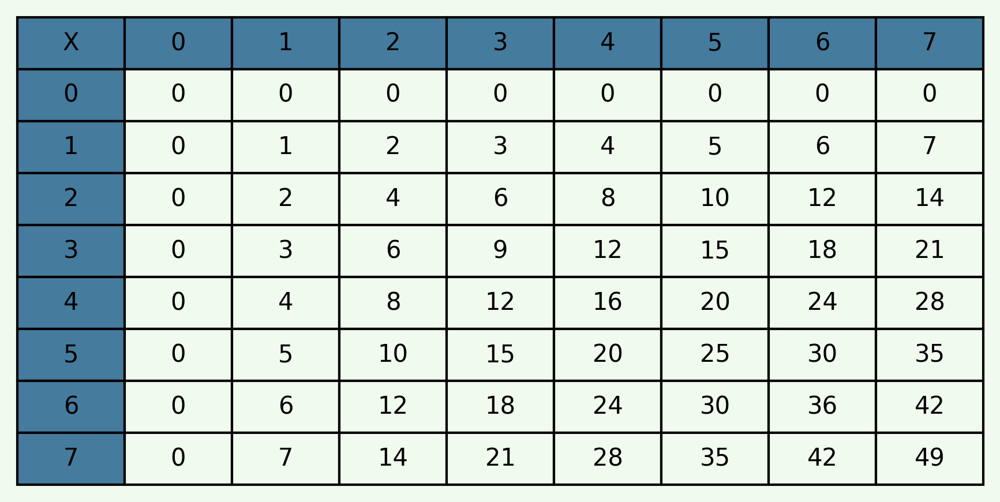

In [189]:
k = 8
data = [["X"]+[str(x) for x in list(range(k))]]
for i in range(k):
    data.append([str(i)]+[str(i * j) for j in range(k)])

multiplication=make_table(data, "",yellow=False,constant_width=True)

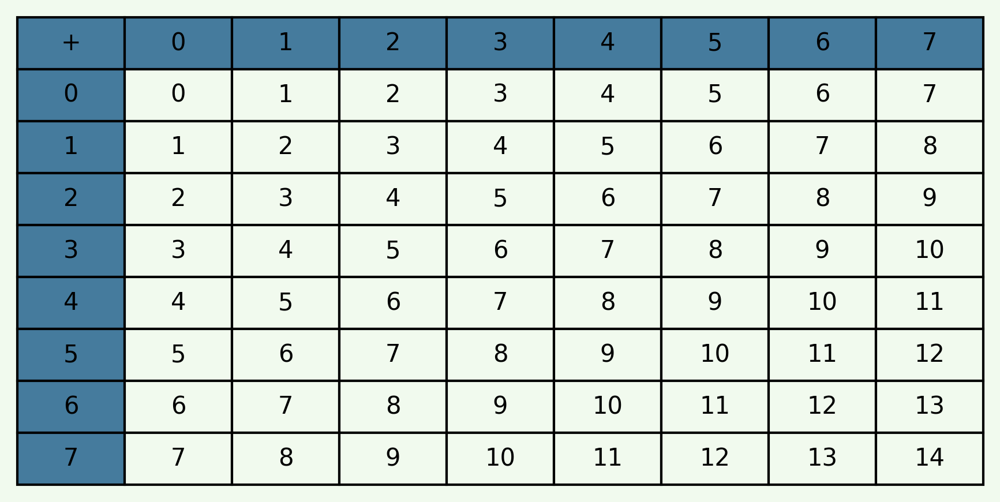

In [190]:
k = 8
data = [["+"]+list(range(k))]
for i in range(k):
    data.append([i]+[i + j for j in range(k)])

multiplication=make_table(data, "",yellow=False)

In [4]:
import math
def f(n):
    return math.factorial(n)**(2*n)

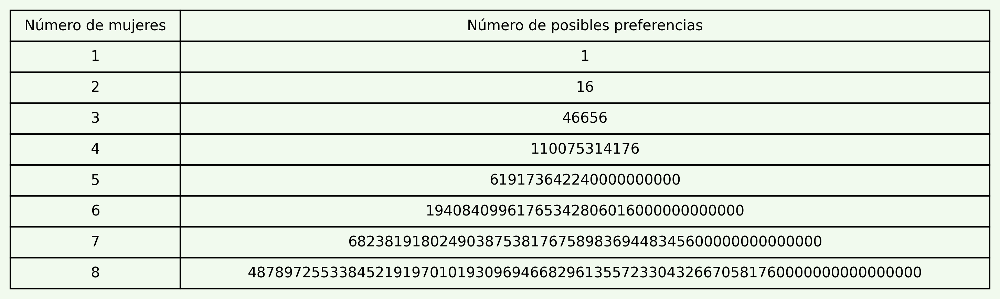

In [10]:
k = 9
data = [["Número de mujeres","Número de posibles preferencias"]]
for i in range(1,k):
    data.append([str(i),str(f(i))])

multiplication=make_table(data, "",constant_width=False)

In [23]:
data_nostalgia=[["Persona","Nostalgia"],["Bob",3],["Dan",0],["Fer",2],["Jay",2],["Ada",1],["Eva",0],["Lea",2],["Mia",2]]

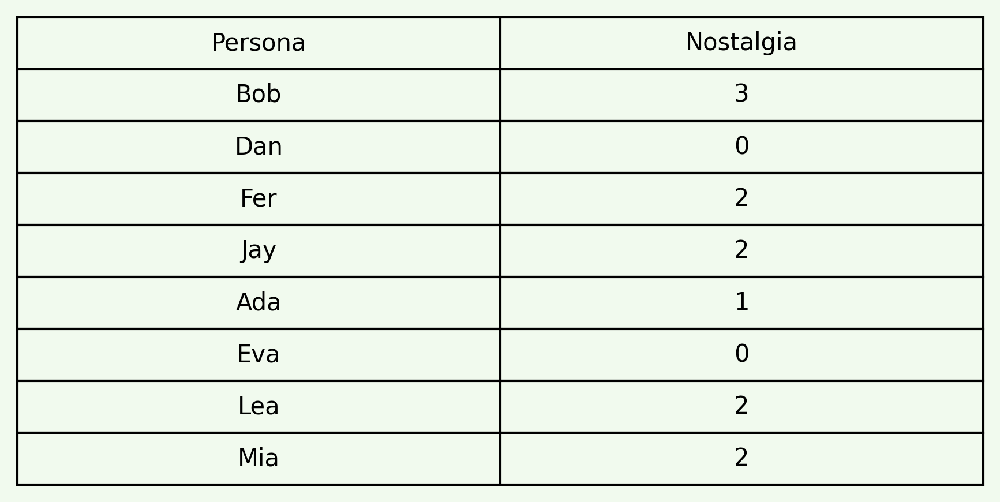

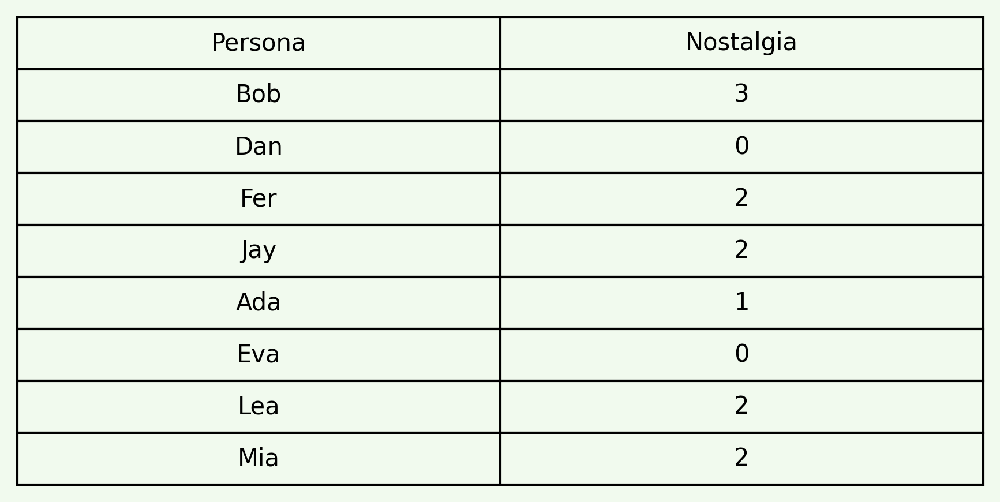

In [24]:
make_table(data_nostalgia,"")

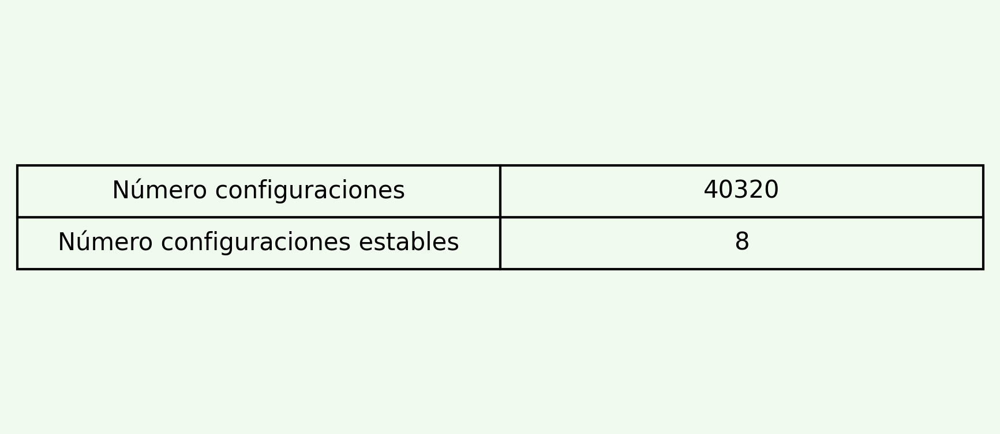

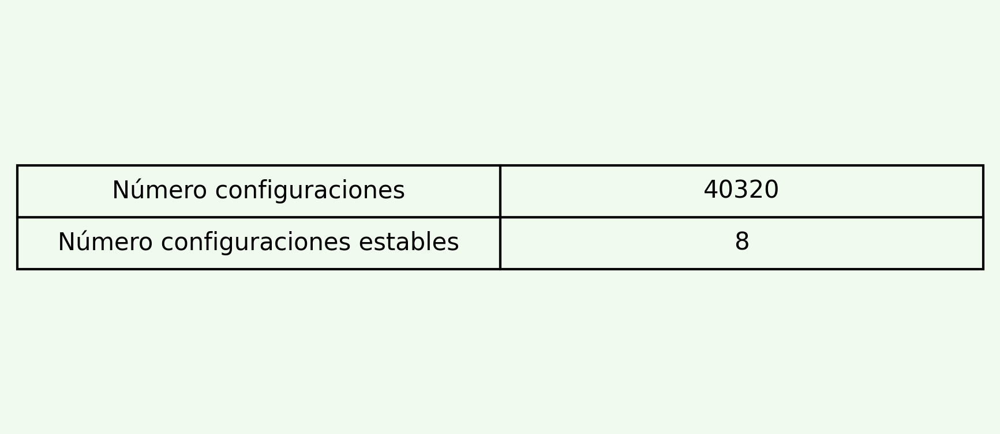

In [204]:
data=[]
data.append(["Número configuraciones",str(math.factorial(8))])
data.append(["Número configuraciones estables","8"])
make_table(data,"")

In [201]:
A=14000*10**6*365*24*60*60

In [162]:
int(B/A)

110508003401657096244019144889961395468099324341880094720

In [202]:
A

441504000000000000

In [198]:
math.factorial(8)

40320

### Make all stable marriages

#def draw_com(people:list,proposals:list,relationships:list,p_matrix,d_matrix,title,alphabetical=True,men_propose=True):

In [25]:
sm_by_women_sadness=[(4, 3, 0, 5, 1, 7, 6, 2),
 (4, 6, 0, 5, 1, 7, 3, 2),
 (4, 3, 0, 5, 1, 2, 6, 7),
 (1, 3, 0, 5, 4, 7, 6, 2),
 (4, 6, 0, 5, 1, 2, 3, 7),
 (1, 6, 0, 5, 4, 7, 3, 2),
 (1, 3, 0, 5, 4, 2, 6, 7),
 (1, 6, 0, 5, 4, 2, 3, 7)]
men_pref=[[2, 4, 6, 7, 0, 3, 5, 1],
 [0, 2, 4, 6, 7, 3, 1, 5],
 [5, 2, 1, 0, 4, 7, 3, 6],
 [6, 1, 4, 5, 0, 7, 3, 2],
 [4, 2, 6, 1, 0, 7, 3, 5],
 [3, 6, 2, 1, 5, 4, 7, 0],
 [1, 7, 2, 4, 0, 3, 6, 5],
 [6, 7, 5, 0, 2, 4, 3, 1]]
women_pref=[[4, 0, 1, 5, 7, 2, 6, 3],
 [1, 3, 6, 5, 4, 0, 7, 2],
 [0, 1, 7, 4, 2, 5, 6, 3],
 [4, 1, 2, 3, 5, 7, 0, 6],
 [1, 0, 4, 2, 6, 5, 7, 3],
 [0, 7, 2, 5, 6, 4, 1, 3],
 [6, 3, 4, 5, 2, 1, 7, 0],
 [2, 1, 7, 4, 0, 3, 6, 5]]

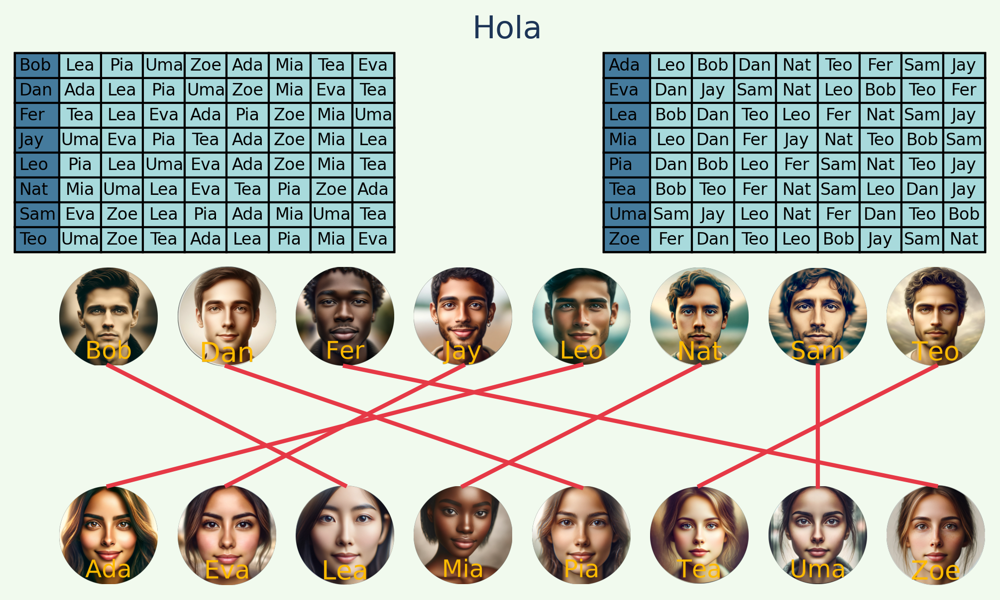

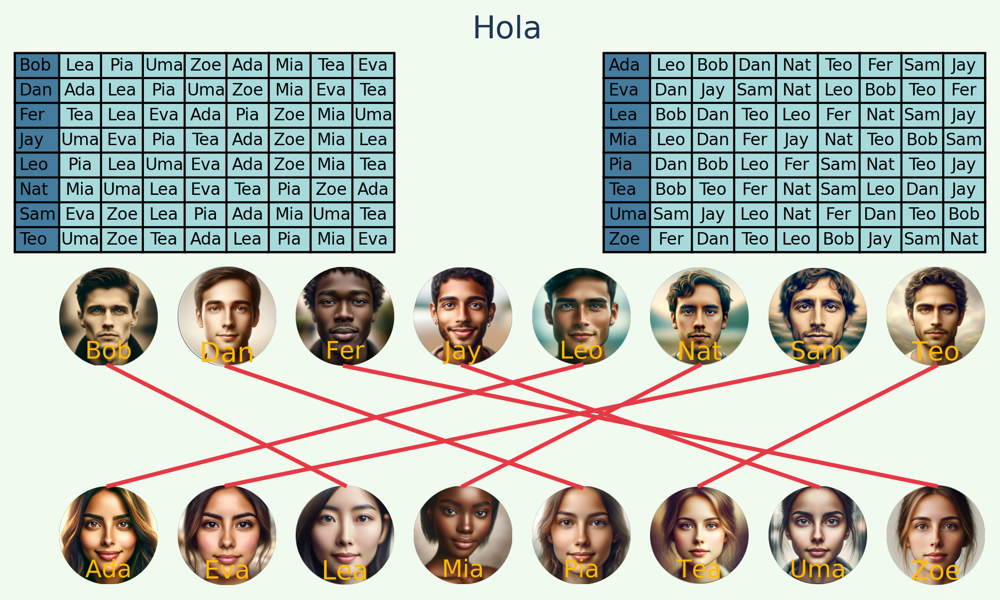

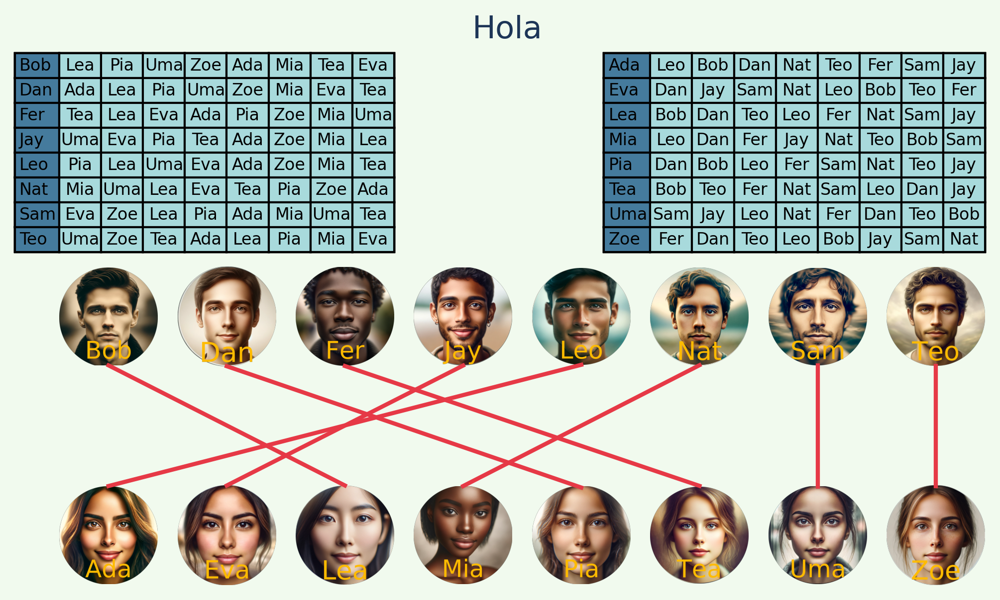

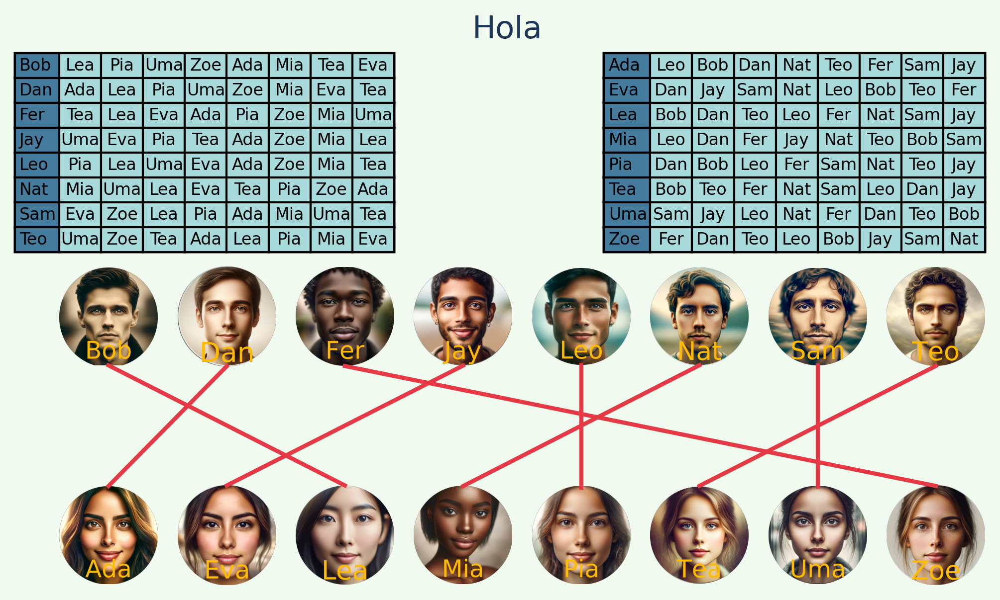

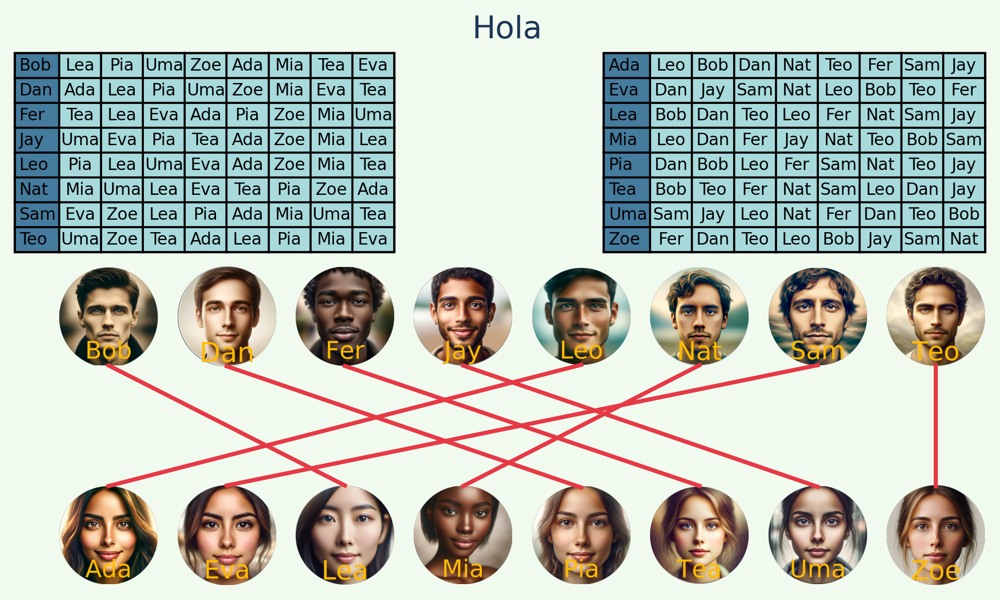

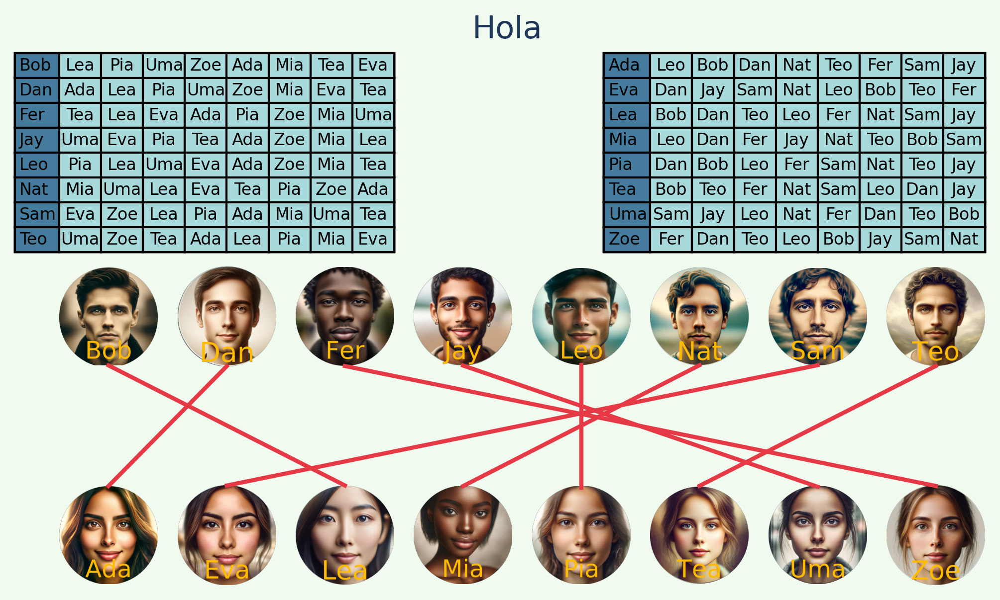

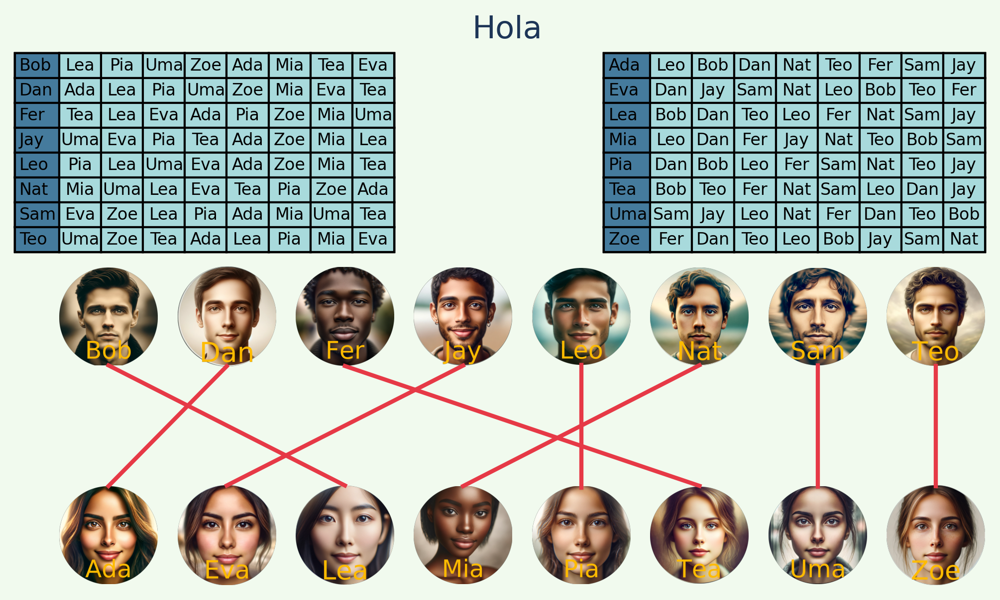

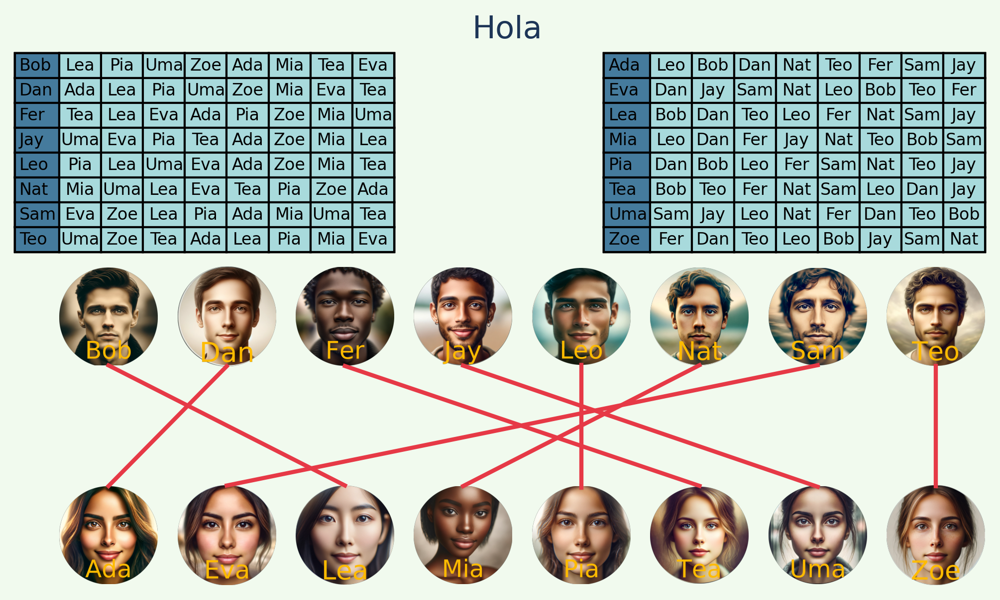

In [26]:
stable_marriages=[]

for j in range(8):    
    k=8
    people=men_names[:k]+women_names[:k]
    relationships_list=list([sm_by_women_sadness[j]][0])
    relationships=[[relationships_list[i],i] for i in range(k)]
    img=draw_com(people,[],relationships,men_pref,women_pref,"Hola")
    stable_marriages.append(img)

In [28]:
for i,item in enumerate(stable_marriages):
    item.savefig("/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley/All_stable_marriages"+str(i))

In [34]:
for i in range(8):
    folder_path="/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley/All_stable_marriages/"
    a=str(i)
    # Open the original image
    original_image = Image.open(f"{folder_path}All_stable_marriages{a}.png")

    # Define the area to crop (left, upper, right, lower)
    crop_area = (200, 650, 2300, 1300)  # Adjust these values to your needs

    # Crop the image
    cropped_image = original_image.crop(crop_area)
    cropped_image.save("/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley/All_stable_marriages/"+"SM_"+str(i)+".png")

# Save the cropped image

In [38]:
folder_path="/Users/camiloariasabad/Desktop/Teaching/Topics_Algorithms_2023/Notebooks_for_Topics_on_Algorithms/Explora_Gale_Shapley/Images_Gale_Shapley/All_stable_marriages/"
image_paths=[f"{folder_path}SM_{str(i)}.png" for i in range(8)]

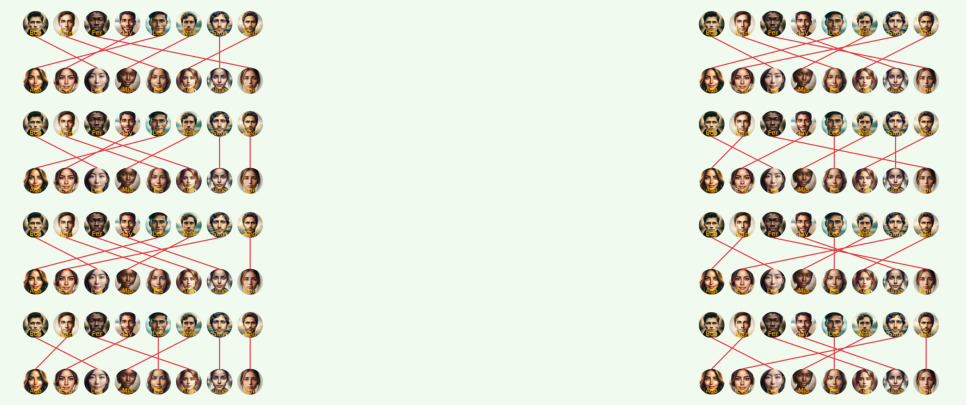

In [41]:

# Create a figure with a grid of subplots
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(16, 5))
fig.patch.set_facecolor("#F1FAEE")

# Flatten the array of axes (subplots)
axs = axs.flatten()

for ax, img_path in zip(axs, image_paths):
    # Load the image
    img = Image.open(img_path)
    # Display the image
    ax.imshow(img)
    # Remove axis labels
    ax.axis('off')

# Adjust layout to prevent overlapping
#plt.tight_layout()

# Display the plot
plt.show()


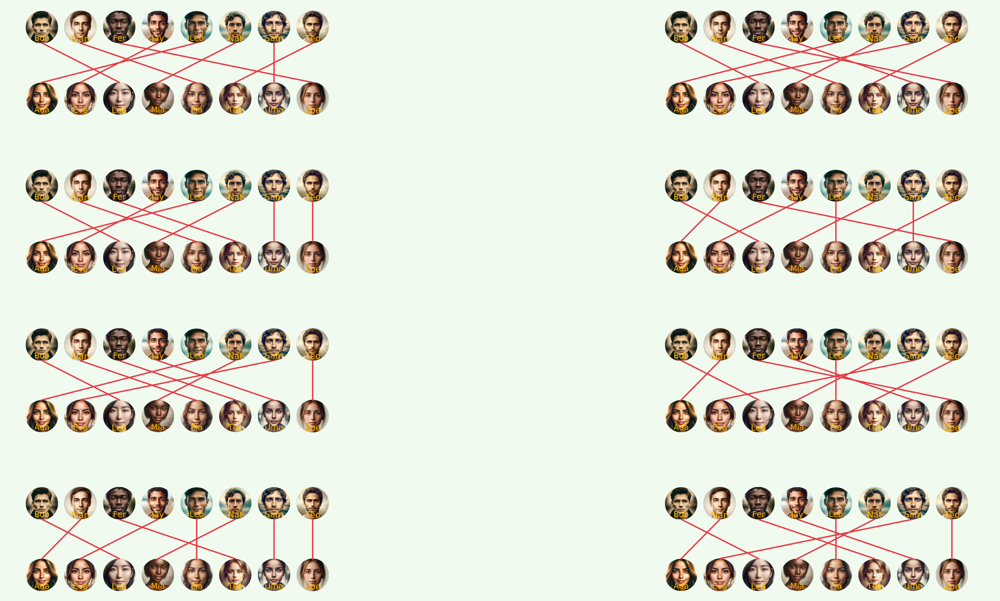

In [51]:

# Create a figure with a grid of subplots
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(16, 8),dpi=300)
fig.patch.set_facecolor("#F1FAEE")

# Flatten the array of axes (subplots)
axs = axs.flatten()

for ax, img_path in zip(axs, image_paths):
    # Load the image
    img = Image.open(img_path)
    # Display the image
    ax.imshow(img)
    # Remove axis labels
    ax.axis('off')

# Adjust layout to prevent overlapping, add more vertical space between subplots
plt.subplots_adjust(hspace=0.5)  # You can adjust the value of hspace as needed

# Display the plot
plt.show()

In [54]:
fig.savefig("stable_marriages_all.png")